In [1]:
#importing libraries
import pandas as pd
import numpy as np 
import os
import matplotlib.pyplot as plt
import sklearn
import seaborn as sns
from scipy.stats import shapiro,normaltest
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from collections import Counter


In [2]:
training_data = pd.read_csv("full_training_data_1988-2016")
#get rid of irrelevant index column that was grabbed from Basketball Reference
training_data = training_data.drop(training_data.columns[0],axis=1)
print("The shape of our training data is:",training_data.shape)
training_data.describe()


The shape of our training data is: (12204, 94)


,Age,G,MP,FG_per_game,FGA_per_game,FG%_per_game,3P_per_game,3PA_per_game,3P%_per_game,2P_per_game,...,USG%_advanced,OWS_advanced,DWS_advanced,WS_advanced,WS/48_advanced,OBPM_advanced,DBPM_advanced,BPM_advanced,VORP_advanced,Year
count,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,...,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000,12204.000000
mean,26.930515,54.158391,20.566544,3.105457,6.898484,0.436438,0.443084,1.278909,0.220005,2.661734,...,18.884718,1.411849,1.312021,2.724672,0.072227,-1.524320,-0.197255,-1.721452,0.651041,2003.066208
std,4.189863,25.028675,10.334851,2.223850,4.664459,0.092498,0.598784,1.583408,0.183008,2.039795,...,5.394303,2.143913,1.262424,3.096550,0.097404,3.703297,1.767466,4.628215,1.408085,7.998363
min,18.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,-3.300000,-1.000000,-2.100000,-2.519000,-68.900000,-26.100000,-92.100000,-2.600000,1989.000000
25%,24.000000,35.000000,11.800000,1.300000,3.200000,0.401000,0.000000,0.000000,0.000000,1.100000,...,15.400000,0.000000,0.300000,0.300000,0.037000,-3.200000,-1.000000,-3.500000,-0.100000,1996.000000
50%,26.000000,62.000000,19.900000,2.500000,5.800000,0.441000,0.100000,0.500000,0.272000,2.100000,...,18.600000,0.600000,1.000000,1.700000,0.080000,-1.300000,-0.200000,-1.400000,0.100000,2003.000000
75%,30.000000,76.000000,29.300000,4.500000,9.800000,0.482000,0.700000,2.100000,0.357000,3.800000,...,22.100000,2.300000,2.000000,4.200000,0.120000,0.500000,0.700000,0.600000,1.000000,2010.000000
max,44.000000,85.000000,43.700000,12.700000,27.800000,1.000000,5.100000,11.200000,1.000000,12.100000,...,100.000000,14.900000,9.100000,20.400000,2.123000,42.500000,60.700000,97.400000,11.800000,2016.000000


In [19]:
#creating subsets of data based on 4 categories: per_game, per_poss, per_minute, and advanced
per_game_stats = training_data.filter(regex="_per_game$")
per_minute_stats = training_data.filter(regex="_per_minute$")
per_poss_stats = training_data.filter(regex="_per_poss$")
advanced_stats = training_data.filter(regex="_advanced$")


In [3]:
#From this section, we can see that we have no null values in our training data
null_columns = training_data.columns[training_data.isna().any()]
print(training_data[null_columns].isna().sum())

Series([], dtype: float64)


In [4]:
#calculating the ratio of zeros in the dataset
for name in training_data.columns:
    print(name, round((training_data.loc[:,name].isin([0]).sum()/len(training_data.loc[:,name]))*100,2))
#as we can see, most columns do not have a large number of zeros so the data is dense

Player 0.0
Pos 0.0
Age 0.0
Tm 0.0
G 0.0
MP 0.02
FG_per_game 1.29
FGA_per_game 0.34
FG%_per_game 1.29
3P_per_game 42.04
3PA_per_game 27.38
3P%_per_game 33.25
2P_per_game 1.55
2PA_per_game 0.44
2P%_per_game 1.53
eFG%_per_game 1.29
FT_per_game 3.75
FTA_per_game 2.91
FT%_per_game 3.58
ORB_per_game 3.51
DRB_per_game 1.36
TRB_per_game 0.93
AST_per_game 3.06
STL_per_game 4.62
BLK_per_game 14.11
TOV_per_game 1.93
PF_per_game 1.03
PTS_per_game 0.97
FG_per_minute 1.29
FGA_per_minute 0.34
FG%_per_minute 1.29
3P_per_minute 38.85
3PA_per_minute 22.25
3P%_per_minute 33.25
2P_per_minute 1.53
2PA_per_minute 0.44
2P%_per_minute 1.53
FT_per_minute 3.59
FTA_per_minute 2.89
FT%_per_minute 3.58
ORB_per_minute 3.2
DRB_per_minute 1.37
TRB_per_minute 0.93
AST_per_minute 2.87
STL_per_minute 4.29
BLK_per_minute 9.98
TOV_per_minute 1.91
PF_per_minute 1.03
PTS_per_minute 0.97
FG_per_poss 1.29
FGA_per_poss 0.34
FG%_per_poss 1.29
3P_per_poss 37.15
3PA_per_poss 20.11
3P%_per_poss 33.25
2P_per_poss 1.53
2PA_per_poss 

Now we will test the normality of each column by using the Shapiro-Wilk test and the D'Agostino's K^2 test

In [5]:
#creating new panda that contains only the numerical statistic 
normal_test_panda = training_data.drop(['Player','Pos','Age','Tm','G','MP','Year','All_NBA'],axis=1)
# Shapiro-Wilk test
shapiro_results = []
normal_col_count_shapiro = 0
nonnormal_col_count_shapiro = 0
for col_name in normal_test_panda.columns:
    stat,p = shapiro(normal_test_panda.loc[:,col_name])
    shapiro_results.append((col_name,stat,p))
    if p < 0.05:
        # print(col_name,"is not normally distributed according to the Shapiro-Wilk test")
        nonnormal_col_count_shapiro += 1
    else:
        # print(col_name,"is normally distributed according to the Shapiro-Wilk test")
        normal_col_count_shapiro += 1
print("The number of normal columns according to the Shapiro Test is {}".format(normal_col_count_shapiro))
print("The number of normal columns according to the Shapiro Test is {}".format(nonnormal_col_count_shapiro))
#D'Agostino test
dagostino_results = []
normal_col_count_dagostino = 0
nonnormal_col_count_dagostino = 0
for col_name in normal_test_panda.columns:
    stat,p = normaltest(normal_test_panda.loc[:,col_name])
    dagostino_results.append((col_name,stat,p))
    if p < 0.05:
        # print(col_name,"is not normally distributed according to the D'Agostino test")
        nonnormal_col_count_dagostino += 1
    else:
        # print(col_name,"is normally distributed according to the D'Agostino test")
        normal_col_count_dagostino += 1
print("The number of normal according to the D'agostino Test columns is {}".format(normal_col_count_dagostino))
print("The number of non-normal according to the D'agostino Test columns is {}".format(nonnormal_col_count_dagostino))



The number of normal columns according to the Shapiro Test is 0
The number of normal columns according to the Shapiro Test is 86
The number of normal according to the D'agostino Test columns is 0
The number of non-normal according to the D'agostino Test columns is 86


From the cell above, we can see that no columns of data are normally distributed. 

Now, we will perform dimensionality reduction to help with our later analysis

In [22]:
#perform PCA on data
#first, get rid of the non-number columns
data_pca = training_data.drop(['Player','Pos','Tm','Year'],axis=1)
data_numpy = data_pca.to_numpy()

pca = PCA(n_components=20)
pca_results = pca.fit_transform(data_numpy)
print('Explained variation per principal component:{}'.format(pca.explained_variance_ratio_))
print('Explained variation per sum of principal component:{}'.format(np.sum(pca.explained_variance_ratio_)))

# print(pca.components_)
# print(np.shape(pca.components_))


Explained variation per principal component:[0.47874373 0.13935143 0.11199864 0.09287864 0.04319632 0.03281946
 0.01900051 0.01648744 0.01233119 0.01156049 0.00958512 0.00833354
 0.00662767 0.00362307 0.00325268 0.00209408 0.00158086 0.00123408
 0.00097555 0.00077731]
Explained variation per sum of principal component:0.9964518129040246


In [ ]:
#perform tSNE on all data
tsne = TSNE(n_components=2)
tsne_50_results = tsne.fit_transform(data_pca)

#perform tSNE on pca data
# tsne = TSNE(n_components=2)
# tsne_50_results = tsne.fit_transform(pca_results)

#visualizing tSNE
data_pca["results1"] = tsne_50_results[:,0]
data_pca["results2"] = tsne_50_results[:,1]

plt.figure(figsize=[16,10])
sns.scatterplot(
    x="results1",y="results2",
    hue="All_NBA",
    palette=sns.color_palette("husl",2),
    data=data_pca,
    legend="full",
    alpha=0.3
)

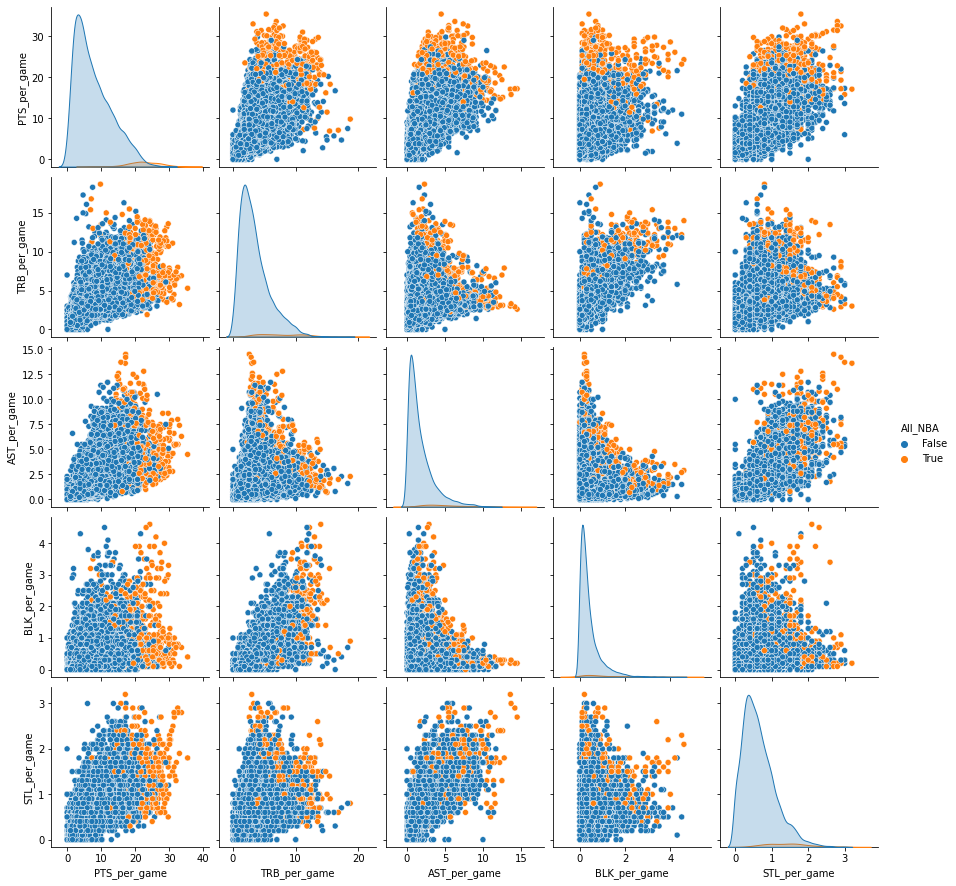

In [21]:
# #showing distribution of randomly chosen variables
# df = training_data.select_dtypes(exclude=['object'])
# print(df.columns)

# sample = df.sample(n=5,axis='columns')

sns.pairplot(training_data,'All_NBA',vars=["PTS_per_game","TRB_per_game","AST_per_game","BLK_per_game","STL_per_game"])
# sns.pairplot(df,hue='All_NBA',vars=sample.columns)

